## Introduction

This is a tutorial about how to use the `fmi` library.  `fmi` easily integrates with fastai.medical.imaging adding additional functionality.  

- Details about **fastai.medical.imaging** can be found [here](https://github.com/fastai/fastai/blob/master/nbs/60_medical.imaging.ipynb), there is also a tutorial [here](https://github.com/fastai/fastai/blob/master/nbs/61_tutorial.medical_imaging.ipynb). Fastai installation info can be found [here](https://github.com/fastai)


- To learn more about medical imaging I have a **medical imaging blog [here](https://asvcode.github.io/MedicalImaging/)**


fmi's goal is to be able to provide an end to end way of exploring, preprocessing, training and evaluting medical image datasets.

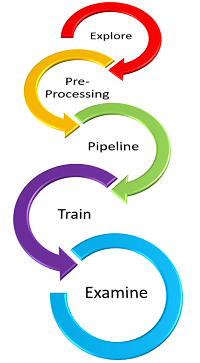

- **Fmi** installation info can be found [here](https://github.com/asvcode/fmi)

The dataset that is used in this tutorial is from the OSIC Pulmonary Fibrosis Progression dataset [source](https://www.kaggle.com/c/osic-pulmonary-fibrosis-progression/data).  

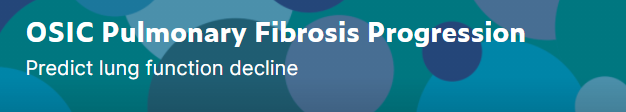

This dataset has over 32600 DICOM images represented by 176 unique patients. There are 2 patient folders in this dataset that require the use of GDCM and will throw out an error if GDCM is not installed.  If you use the accompanying Kaggle [kernel]() you can easily install GDCM.  

However if you are using your own machine then that can be tricky so I removed the 2 folders for this tutorial.  The 2 folders are `'ID00011637202177653955184'` and `'ID00052637202186188008618'`.

## Goals

The goals of this tutorial are:

- Explain some of the features of the `fmi` library


- Medical imaging datasets are often large(in this example there are over 32600 images). What can we do to reduce the size of the dataset for initial prototyping


- Explain how to remove areas of images that have no relevance to the training process


- Save .dcm images into .jpg format where each channel represents a different window width and level


- With medical datasets it is important to ensure that the same patient is not represented in the training and validation datasets.  Explain how `dicom_splitter` works in ensuring the same patient is not represented in both sets


- Show example DataBlock's

In [1]:
from fastai.vision.all import *
from fastai.tabular.all import *
from fastai.medical.imaging import *
import seaborn as sns
import imageio

from torchvision.utils import save_image
matplotlib.rcParams['image.cmap'] = 'bone'

load the fmi library

In [2]:
from fmi.explore import *
from fmi.preprocessing import *
from fmi.pipeline import *

## Exploring & Preprocessing

In this tutorial predominantly look at 2 of the `fmi` modules: explore and preprocessing and briefly touch on pipeline

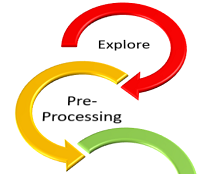

Calling `system_info` conveniently provides system details.  To be able to use fastai.medical.imaging you need to install pydicom and kornia

In [3]:
system_info()

fastai Version: 2.6.0
fastcore Version: 1.3.27
python Version: 3.8.10 (default, May 19 2021, 13:12:57) [MSC v.1916 64 bit (AMD64)]
torchvision: 0.11.1+cu113
torch version: 1.10.0+cu113

Cuda: True
Cuda Version: 11.3
GPU: NVIDIA GeForce RTX 3070 Laptop GPU

pydicom Version: 2.1.2
kornia Version: 0.2.0


In [4]:
source = 'D:/Datasets/osic-pulmonary-fibrosis-progression'
train_source = 'D:/Datasets/osic-pulmonary-fibrosis-progression/train'
os_items = get_dicom_files(source, folders='train')
os_items

(#32684) [Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/1.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/10.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/11.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/12.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/13.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/14.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/15.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/16.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/17.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/18.dcm')...]

This dataset consists of 32684 images derived from 176 CT scans.  It is important to know the differences between the types of medical images.

- **X-Ray:** are projected down at the body from a single direction to capture a single image.

- **CT:** or Computed Tomography also uses x-ray but they emit x-rays from many different angles around the human body to capture more detail from different angles.

- **MRI:** or Magnetic Resonance Imaging uses strong magnetic fields to create images of areas of the body from different angles. Particularly used in scans of the brain.

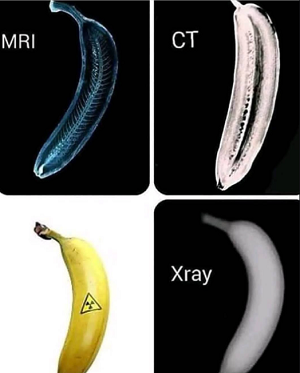 [Image Credit](https://imgur.com/gallery/60OC2ME)

CT scans involve having many 2D images that represent different slices through the body but they can be combined to construct a whole picture(viewed in different planes) or a 3D image.

`get_image_info` is a handy function that displays image specific identifiers in the head of the dicom

In [5]:
get_image_info(os_items[7])

(0008, 0060) Modality                            CS: 'CT'
(0028, 0004) Photometric Interpretation          CS: 'MONOCHROME2'
(0028, 0030) Pixel Spacing                       DS: [0.652344, 0.652344]
(0018, 0050) Slice Thickness                     DS: "1.25"
(0028, 0100) Bits Allocated                      US: 16
(0028, 1052) Rescale Intercept                   DS: "-1024.0"
(0028, 1053) Rescale Slope                       DS: "1.0"


It is also important to check to see if there are any patient specify identifiers within the head of the dicom.  I am referring to patient specify identifiers as things such as age, sex and patient comments.

`get_pii` is a handy function that checks for patient identifiers.

In [6]:
get_pii(os_items[7])

(0010, 0010) Patient's Name                      PN: 'ID00007637202177411956430'
No Patient Birth Date
(0010, 0040) Patient's Sex                       CS: ''
No patient Age
No Image Comments


There are no patient specific identifiers in this dataset

In this dataset each folder represents 1 patient.  Looking at one patient `'ID00007637202177411956430'`

In [7]:
patient_one = get_dicom_files(train_source, folders='ID00007637202177411956430')
patient_one

(#30) [Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/1.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/10.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/11.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/12.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/13.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/14.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/15.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/16.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/17.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/18.dcm')...]

This folder has 30 images and we can do something like this to view the images

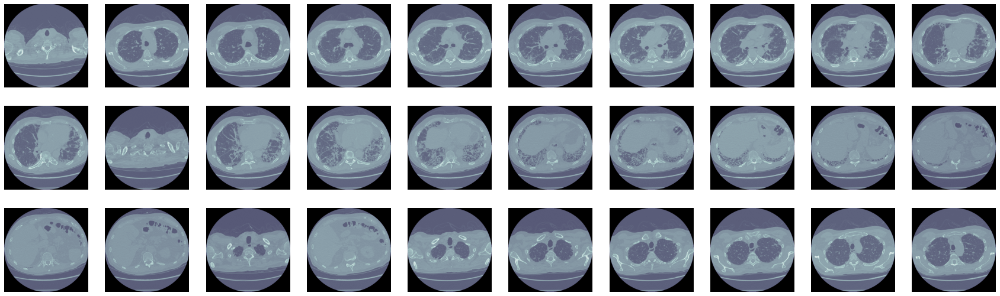

In [8]:
fx = []
for i in patient_one:
    im = TensorDicom(i.dcmread().pixel_array)
    fx.append(im)
show_images(fx, nrows=3)

What you notice is that the slices are not in sequence.  This can be easily be fixed by using `instance_sort` which returns an `L` object. More about L can be found [here](https://fastcore.fast.ai/foundation#L) 

In [9]:
instance_sort(patient_one)

(#30) [["1", Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/1.dcm')],["2", Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/2.dcm')],["3", Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/3.dcm')],["4", Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/4.dcm')],["5", Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/5.dcm')],["6", Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/6.dcm')],["7", Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/7.dcm')],["8", Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/8.dcm')],["9", Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00007637202177411956430/9.dcm')],["10", Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID000076372021774

View images using `instance_sort`

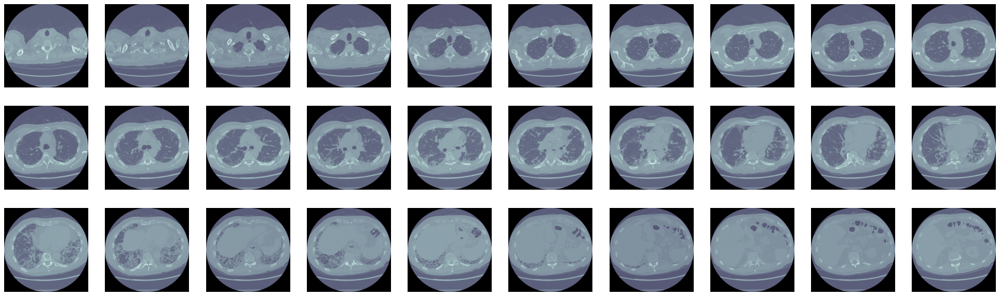

In [10]:
fxs = []
for i in instance_sort(patient_one):
    im = TensorDicom(i[1].dcmread().pixel_array)
    fxs.append(im)
show_images(fxs, nrows=3)

However to make it easier you can simply call `instance_show` which will show the images in sequence and display the instance number.

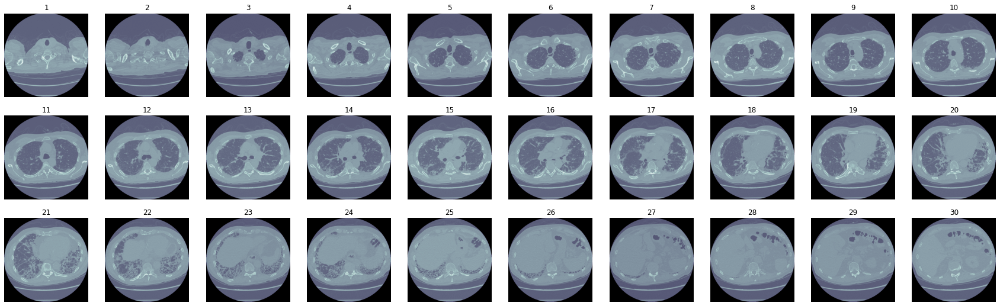

In [11]:
instance_show(patient_one, nrows=3)

As mentioned before CT scans are made up of numerous 2D slices taken from a number of angles(or planes).  The 3 planes are axial, sagittal and cornonal and the image below show what angels the planes represent.  [Image credit](https://www.ipfradiologyrounds.com/hrct-primer/image-reconstruction/)

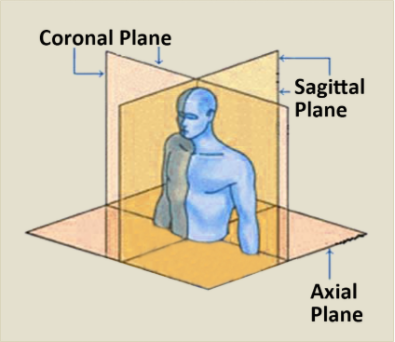

`show_aspects` provides a convenient way of viewing 3 planes.  There is also the option to save the 3 planes as seperate jpg images

Number of slices: 30


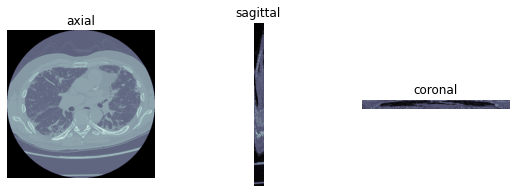

In [12]:
show_aspects(patient_one, show=True, save=False)

Datasets can be made up of images taken with different imaging machines.  In this dataset alone there were 7 different machines that were used and this can be validated by checking for unique values of `ManufacturerModelName`.  This can impact how the images look depending on whether they are viewed in `unit8`, `unit16` or `float32`.  This will also impact how the images are saved.

`show_aspect` by default uses `float32` but you can specify the value to use

Number of slices: 30


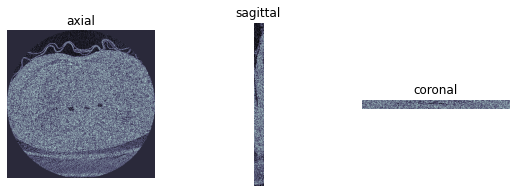

In [13]:
show_aspects(patient_one, show=True, atype=np.uint8)

Number of slices: 30


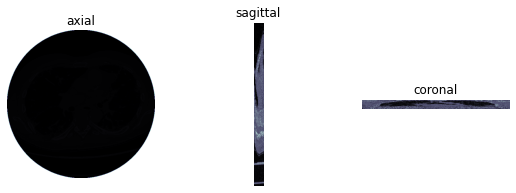

In [14]:
show_aspects(patient_one, show=True, atype=np.uint16)

Number of slices: 30


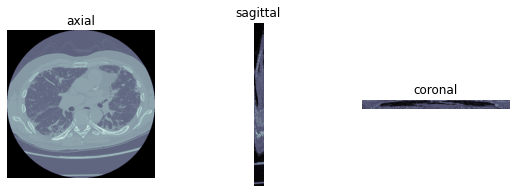

In [15]:
show_aspects(patient_one, show=True, atype=np.float32)

The example above only have 30 slices, the example below has 408 slices.

In [16]:
patient_two = get_dicom_files(train_source, folders='ID00186637202242472088675')
patient_two

(#408) [Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00186637202242472088675/1.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00186637202242472088675/10.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00186637202242472088675/100.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00186637202242472088675/101.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00186637202242472088675/102.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00186637202242472088675/103.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00186637202242472088675/104.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00186637202242472088675/105.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00186637202242472088675/106.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00186637202242472088675/107.dcm')...]

Number of slices: 408


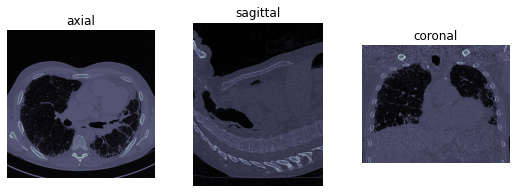

In [17]:
show_aspects(patient_two, show=True, save=False)

`show_aspects` has the option to save the different aspect images.  There are 176 patients (174 in this tutorial as explained earlier) in this dataset so we can expect to get 176 images for each aspect; axial, sagittal and coronal.  It is important to note that the axial aspect is simply a single slice taken from the middle, unlike the sagittal and coronal aspects which are made up by combining all the slices together

>Note! We will save the different aspects which is explained further below

Dicoms contains a wealth of information contained in the `header` of the dicom.  You can read more [here](https://asvcode.github.io/MedicalImaging/).  Fastai provides a convenient way of extracting the attributes within the header and returning the attributes in a dataframe.  The great thing is this is done in parallel.

 The use of `from_dicoms` is slightly tweaked so that you can directly specify the window width and level when you call the function.  To learn more about windows you can view my article [here](https://towardsdatascience.com/a-matter-of-grayscale-understanding-dicom-windows-1b44344d92bd)

In the example below we use the `mediastinum` window.

In [18]:
patient_df = pd.DataFrame.from_dicoms(patient_one, window=dicom_windows.mediastinum)
patient_df[:2]

,SpecificCharacterSet,ImageType,SOPInstanceUID,Modality,Manufacturer,ManufacturerModelName,PatientName,PatientID,PatientSex,DeidentificationMethod,...,ImageOrientationPatient3,ImageOrientationPatient4,ImageOrientationPatient5,MultiPixelSpacing,PixelSpacing1,img_min,img_max,img_mean,img_std,img_pct_window
0,ISO_IR 100,ORIGINAL,2.25.12297650151329871895440507938349160734,CT,GE MEDICAL SYSTEMS,LightSpeed VCT,"(I, D, 0, 0, 0, 0, 7, 6, 3, 7, 2, 0, 2, 1, 7, 7, 4, 1, 1, 9, 5, 6, 4, 3, 0)",ID00007637202177411956430,,Table;,...,0.0,1.0,0.0,1,0.652344,-2000,2842,-1.454884,1137.488858,0.219498
1,ISO_IR 100,ORIGINAL,2.25.37611372879908126511187998276199853341,CT,GE MEDICAL SYSTEMS,LightSpeed VCT,"(I, D, 0, 0, 0, 0, 7, 6, 3, 7, 2, 0, 2, 1, 7, 7, 4, 1, 1, 9, 5, 6, 4, 3, 0)",ID00007637202177411956430,,Table;,...,0.0,1.0,0.0,1,0.652344,-2000,2918,19.038597,1138.876560,0.248634


You can now view all the attributes from the `header` of the dicom in a convenient dataframe.  You have to scroll all the way to the right to view the mean, standard deviation and image window %(the % of pixels in the image that fall within the range of the choosen window width and level).  The location of the image file is also included (this is important as it is easier to use when constructing your DataBlock).

If you change to the lungs window you can view the updated `img_pct_window` values.

In [19]:
patient_df = pd.DataFrame.from_dicoms(patient_one, window=dicom_windows.lungs)
patient_df[:2]

,SpecificCharacterSet,ImageType,SOPInstanceUID,Modality,Manufacturer,ManufacturerModelName,PatientName,PatientID,PatientSex,DeidentificationMethod,...,ImageOrientationPatient3,ImageOrientationPatient4,ImageOrientationPatient5,MultiPixelSpacing,PixelSpacing1,img_min,img_max,img_mean,img_std,img_pct_window
0,ISO_IR 100,ORIGINAL,2.25.12297650151329871895440507938349160734,CT,GE MEDICAL SYSTEMS,LightSpeed VCT,"(I, D, 0, 0, 0, 0, 7, 6, 3, 7, 2, 0, 2, 1, 7, 7, 4, 1, 1, 9, 5, 6, 4, 3, 0)",ID00007637202177411956430,,Table;,...,0.0,1.0,0.0,1,0.652344,-2000,2842,-1.454884,1137.488858,0.702209
1,ISO_IR 100,ORIGINAL,2.25.37611372879908126511187998276199853341,CT,GE MEDICAL SYSTEMS,LightSpeed VCT,"(I, D, 0, 0, 0, 0, 7, 6, 3, 7, 2, 0, 2, 1, 7, 7, 4, 1, 1, 9, 5, 6, 4, 3, 0)",ID00007637202177411956430,,Table;,...,0.0,1.0,0.0,1,0.652344,-2000,2918,19.038597,1138.876560,0.720448


You can create a dataframe for the whole dataset like so: (caution: depending on your specs this could take a while, on my system it took just under 12 minutes)

In [20]:
%%time
dicom_dataframe = pd.DataFrame.from_dicoms(os_items, window=dicom_windows.lungs)

Wall time: 11min 30s


Save the dataframe as a csv file.

In [20]:
dicom_dataframe = pd.read_csv(f'{source}/dicom_dataframe.csv', low_memory=False)
dicom_dataframe.head()

,SpecificCharacterSet,ImageType,SOPInstanceUID,Modality,Manufacturer,ManufacturerModelName,PatientName,PatientID,PatientSex,DeidentificationMethod,...,WindowCenterWidthExplanation,PatientOrientation,RevolutionTime,SingleCollimationWidth,TotalCollimationWidth,TableSpeed,TableFeedPerRotation,SpiralPitchFactor,SpacingBetweenSlices,SpatialResolution
0,ISO_IR 100,"['ORIGINAL', 'PRIMARY', 'AXIAL']",2.25.12297650151329871895440507938349160734,CT,GE MEDICAL SYSTEMS,LightSpeed VCT,ID00007637202177411956430,ID00007637202177411956430,NaN,Table;,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,ISO_IR 100,"['ORIGINAL', 'PRIMARY', 'AXIAL']",2.25.37611372879908126511187998276199853341,CT,GE MEDICAL SYSTEMS,LightSpeed VCT,ID00007637202177411956430,ID00007637202177411956430,NaN,Table;,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,ISO_IR 100,"['ORIGINAL', 'PRIMARY', 'AXIAL']",2.25.85307440096263309601052352542310417307,CT,GE MEDICAL SYSTEMS,LightSpeed VCT,ID00007637202177411956430,ID00007637202177411956430,NaN,Table;,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,ISO_IR 100,"['ORIGINAL', 'PRIMARY', 'AXIAL']",2.25.46123781426224593247761081441512910006,CT,GE MEDICAL SYSTEMS,LightSpeed VCT,ID00007637202177411956430,ID00007637202177411956430,NaN,Table;,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,ISO_IR 100,"['ORIGINAL', 'PRIMARY', 'AXIAL']",2.25.116080798158038264329904205296840554047,CT,GE MEDICAL SYSTEMS,LightSpeed VCT,ID00007637202177411956430,ID00007637202177411956430,NaN,Table;,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


This dataset has 176 patients and over 32600 images.  This in itself is overwhelming not just because of the sheer number of images but also the compute that will be needed to process all those images.  

**What techniques can you use for rapid prototyping?**

- **Create a smaller dataset** - use only the top 5 images for each patient based on the top image window %.


- **Get rid of areas of the image that have no impact**


- **Save images where each channel represents a dicom window width and level** - this reduces image size and you can save different window width and levels where each image channel contains a different window width and level


Note that there are many ways for rapid prototyping and the ones above are just the ones that I have opted to try.

### Creating a smaller dataset

As shown above you can get the image window % by using `from_dicoms2`.  We can now sort the dataframe by `img_pct_window` and groupby `PatientID`.  Then we can choose the top 5 images for each patientID.

In [21]:
sort_top5 = dicom_dataframe.sort_values(['img_pct_window'],ascending=False).groupby('PatientID').head(5)
sort_top5

,SpecificCharacterSet,ImageType,SOPInstanceUID,Modality,Manufacturer,ManufacturerModelName,PatientName,PatientID,PatientSex,DeidentificationMethod,...,WindowCenterWidthExplanation,PatientOrientation,RevolutionTime,SingleCollimationWidth,TotalCollimationWidth,TableSpeed,TableFeedPerRotation,SpiralPitchFactor,SpacingBetweenSlices,SpatialResolution
8470,ISO_IR 100,"['DERIVED', 'SECONDARY', 'REFORMATTED']",1.2.276.0.7230010.3.1.4.0.37492.1591423399.183666,CT,GE MEDICAL SYSTEMS,OsiriX,ID00105637202208831864134,ID00105637202208831864134,NaN,Table;,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25719,NaN,"['ORIGINAL', 'PRIMARY', 'AXIAL', 'CT_SOM5 SPI']",2.25.67353959036675237221859696444881004919,CT,SIEMENS,Sensation 16,ID00331637202286306023714,ID00331637202286306023714,NaN,Table;,...,"['WINDOW1', 'WINDOW2']",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25721,NaN,"['ORIGINAL', 'PRIMARY', 'AXIAL', 'CT_SOM5 SPI']",2.25.66078556054731154576830309137842816457,CT,SIEMENS,Sensation 16,ID00331637202286306023714,ID00331637202286306023714,NaN,Table;,...,"['WINDOW1', 'WINDOW2']",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25716,NaN,"['ORIGINAL', 'PRIMARY', 'AXIAL', 'CT_SOM5 SPI']",2.25.149150135078074377701358458490416893263,CT,SIEMENS,Sensation 16,ID00331637202286306023714,ID00331637202286306023714,NaN,Table;,...,"['WINDOW1', 'WINDOW2']",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
22580,ISO_IR 100,"['ORIGINAL', 'PRIMARY', 'AXIAL', 'HELIX']",1.2.276.0.7230010.3.1.4.0.37492.1591342612.174453,CT,Philips,OsiriX,ID00285637202278913507108,ID00285637202278913507108,NaN,Table;,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-10.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11354,NaN,"['ORIGINAL', 'PRIMARY', 'AXIAL']",1.2.276.0.7230010.3.1.4.0.37492.1591342000.171977,CT,TOSHIBA,OsiriX,ID00132637202222178761324,ID00132637202222178761324,NaN,Table;,...,NaN,"['L', 'P']",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11365,NaN,"['ORIGINAL', 'PRIMARY', 'AXIAL']",1.2.276.0.7230010.3.1.4.0.37492.1591342000.171978,CT,TOSHIBA,OsiriX,ID00132637202222178761324,ID00132637202222178761324,NaN,Table;,...,NaN,"['L', 'P']",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11342,NaN,"['ORIGINAL', 'PRIMARY', 'AXIAL']",1.2.276.0.7230010.3.1.4.0.37492.1591342000.171976,CT,TOSHIBA,OsiriX,ID00132637202222178761324,ID00132637202222178761324,NaN,Table;,...,NaN,"['L', 'P']",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11276,NaN,"['ORIGINAL', 'PRIMARY', 'AXIAL']",1.2.276.0.7230010.3.1.4.0.37492.1591342000.171970,CT,TOSHIBA,OsiriX,ID00132637202222178761324,ID00132637202222178761324,NaN,Table;,...,NaN,"['L', 'P']",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


By doing this we have now reduced the data size from over 32600 and just 870.

Save the updated dataframe as a csv 

In [22]:
sort_top5.to_csv(f'{source}/sort_top5.csv', index=False)

In [23]:
sorted_five = pd.read_csv(f'{source}/sort_top5.csv')
sorted_five.head()

,SpecificCharacterSet,ImageType,SOPInstanceUID,Modality,Manufacturer,ManufacturerModelName,PatientName,PatientID,PatientSex,DeidentificationMethod,...,WindowCenterWidthExplanation,PatientOrientation,RevolutionTime,SingleCollimationWidth,TotalCollimationWidth,TableSpeed,TableFeedPerRotation,SpiralPitchFactor,SpacingBetweenSlices,SpatialResolution
0,ISO_IR 100,"['DERIVED', 'SECONDARY', 'REFORMATTED']",1.2.276.0.7230010.3.1.4.0.37492.1591423399.183666,CT,GE MEDICAL SYSTEMS,OsiriX,ID00105637202208831864134,ID00105637202208831864134,NaN,Table;,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,"['ORIGINAL', 'PRIMARY', 'AXIAL', 'CT_SOM5 SPI']",2.25.67353959036675237221859696444881004919,CT,SIEMENS,Sensation 16,ID00331637202286306023714,ID00331637202286306023714,NaN,Table;,...,"['WINDOW1', 'WINDOW2']",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,"['ORIGINAL', 'PRIMARY', 'AXIAL', 'CT_SOM5 SPI']",2.25.66078556054731154576830309137842816457,CT,SIEMENS,Sensation 16,ID00331637202286306023714,ID00331637202286306023714,NaN,Table;,...,"['WINDOW1', 'WINDOW2']",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,"['ORIGINAL', 'PRIMARY', 'AXIAL', 'CT_SOM5 SPI']",2.25.149150135078074377701358458490416893263,CT,SIEMENS,Sensation 16,ID00331637202286306023714,ID00331637202286306023714,NaN,Table;,...,"['WINDOW1', 'WINDOW2']",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,ISO_IR 100,"['ORIGINAL', 'PRIMARY', 'AXIAL', 'HELIX']",1.2.276.0.7230010.3.1.4.0.37492.1591342612.174453,CT,Philips,OsiriX,ID00285637202278913507108,ID00285637202278913507108,NaN,Table;,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-10.0,NaN


- Tip: Typical dataframe from dicom metadata will have alot of columns, in this case there are 66 and we do not need to use all of them.  There is a really handy feature in numpy where you can specify what columns to load.  The `r_object` will 'translate slice objects to concatenation along the first axis'.  

Simply put we only want to view the 7th column and columns 50 to 52.

In [24]:
sorted_five_skinny = pd.read_csv(f'{source}/sort_top5.csv', usecols=np.r_[7,50:53])
sorted_five_skinny.head()

,PatientID,img_mean,img_std,img_pct_window
0,ID00105637202208831864134,0.000000,0.000000,1.000000
1,ID00331637202286306023714,558.181076,473.208777,0.991173
2,ID00331637202286306023714,554.200718,472.508603,0.990997
3,ID00331637202286306023714,560.827244,473.850904,0.990986
4,ID00285637202278913507108,306.931527,434.776056,0.990316


Now that we have a smaller dataframe we want to be able to move the files in this dataframe to a seperate folder.

In [25]:
unique_pats = sorted_five['PatientID'].unique().tolist()
len(unique_pats)

174

The dataframe has 174 unique patientID's, remember that I took out 2 patientIDs because you need to have GDCM installed to view those images.  If you use Kaggle you can more easily install GDCM and you would have 176 unique PatientID's.

`move_files` is a convenient function from the fmi library that easily allows you to move files from one folder to another.  You have to specify the source of the image files and the save_path.

In this example we will be moving the top 5 images per patientID based on image window % from the `train` folder to a new folder named `test_5`

In [26]:
for i in unique_pats:
    k = sorted_five[sorted_five['PatientID']==i].sort_values(by=['img_pct_window'], ascending=False)
    move_files(k, source=f'{source}/train', save_path='./test_5/')

Check the moved files

In [27]:
top5 = 'D:/Datasets/osic-pulmonary-fibrosis-progression/test_5'
top5_files = get_dicom_files(top5)
top5_files

(#870) [Path('D:/Datasets/osic-pulmonary-fibrosis-progression/test_5/ID00007637202177411956430/10.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/test_5/ID00007637202177411956430/12.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/test_5/ID00007637202177411956430/13.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/test_5/ID00007637202177411956430/15.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/test_5/ID00007637202177411956430/17.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/test_5/ID00009637202177434476278/100.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/test_5/ID00009637202177434476278/89.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/test_5/ID00009637202177434476278/90.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/test_5/ID00009637202177434476278/95.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/test_5/ID00009637202177434476278/99.dcm')...]

Total of 870 images, 5 images per PatientID

We can now explore further by looking at patient `ID00007637202177411956430`

In [28]:
top5_source = get_dicom_files('D:/Datasets/osic-pulmonary-fibrosis-progression/test_5/ID00007637202177411956430')
save_dir = 'D:/Datasets/osic-pulmonary-fibrosis-progression/save_folder'
top5_dataframe = pd.DataFrame.from_dicoms(top5_source, window=dicom_windows.lungs)
top5_dataframe

,SpecificCharacterSet,ImageType,SOPInstanceUID,Modality,Manufacturer,ManufacturerModelName,PatientName,PatientID,PatientSex,DeidentificationMethod,...,ImageOrientationPatient3,ImageOrientationPatient4,ImageOrientationPatient5,MultiPixelSpacing,PixelSpacing1,img_min,img_max,img_mean,img_std,img_pct_window
0,ISO_IR 100,ORIGINAL,2.25.37611372879908126511187998276199853341,CT,GE MEDICAL SYSTEMS,LightSpeed VCT,"(I, D, 0, 0, 0, 0, 7, 6, 3, 7, 2, 0, 2, 1, 7, 7, 4, 1, 1, 9, 5, 6, 4, 3, 0)",ID00007637202177411956430,,Table;,...,0.0,1.0,0.0,1,0.652344,-2000,2918,19.038597,1138.876560,0.720448
1,ISO_IR 100,ORIGINAL,2.25.46123781426224593247761081441512910006,CT,GE MEDICAL SYSTEMS,LightSpeed VCT,"(I, D, 0, 0, 0, 0, 7, 6, 3, 7, 2, 0, 2, 1, 7, 7, 4, 1, 1, 9, 5, 6, 4, 3, 0)",ID00007637202177411956430,,Table;,...,0.0,1.0,0.0,1,0.652344,-2000,2862,31.026043,1142.850763,0.716293
2,ISO_IR 100,ORIGINAL,2.25.116080798158038264329904205296840554047,CT,GE MEDICAL SYSTEMS,LightSpeed VCT,"(I, D, 0, 0, 0, 0, 7, 6, 3, 7, 2, 0, 2, 1, 7, 7, 4, 1, 1, 9, 5, 6, 4, 3, 0)",ID00007637202177411956430,,Table;,...,0.0,1.0,0.0,1,0.652344,-2000,2815,34.862141,1146.865109,0.716251
3,ISO_IR 100,ORIGINAL,2.25.88514602331893724115921048794426650272,CT,GE MEDICAL SYSTEMS,LightSpeed VCT,"(I, D, 0, 0, 0, 0, 7, 6, 3, 7, 2, 0, 2, 1, 7, 7, 4, 1, 1, 9, 5, 6, 4, 3, 0)",ID00007637202177411956430,,Table;,...,0.0,1.0,0.0,1,0.652344,-2000,2748,55.613979,1152.086567,0.714924
4,ISO_IR 100,ORIGINAL,2.25.39213549175454262443580283010638082248,CT,GE MEDICAL SYSTEMS,LightSpeed VCT,"(I, D, 0, 0, 0, 0, 7, 6, 3, 7, 2, 0, 2, 1, 7, 7, 4, 1, 1, 9, 5, 6, 4, 3, 0)",ID00007637202177411956430,,Table;,...,0.0,1.0,0.0,1,0.652344,-2000,2903,76.050419,1161.019850,0.711266


By using `instance_show` we can see that the top 5 images based on the image window % are images 10, 12, 13, 15 and 17.

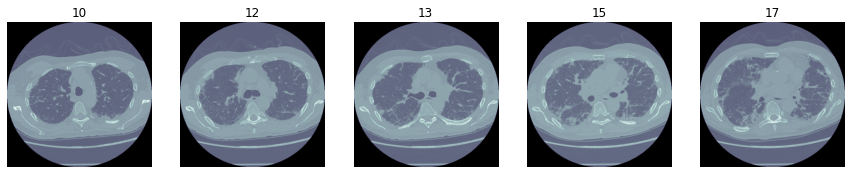

In [29]:
instance_show(top5_source, nrows=1)

`get_dicom_image` is another useful fmi feature that lets you view images from a dataframe and by specific key. You need to specify a source and typically dicom images are stored in a patientID folder and then image or instance number so in this case the images for patient `ID00007637202177411956430` are stored at 'D:/Datasets/osic-pulmonary-fibrosis-progression/test_5/ID00007637202177411956430' so the `folder_val` would be the PatientID and the `instance_val` would be the InstanceNumber

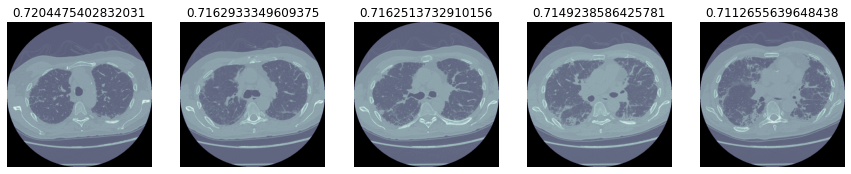

In [30]:
get_dicom_image(top5_dataframe, 'img_pct_window', source=train_source, folder_val='PatientID'\
                , instance_val='InstanceNumber', nrows=1)

View by image mean

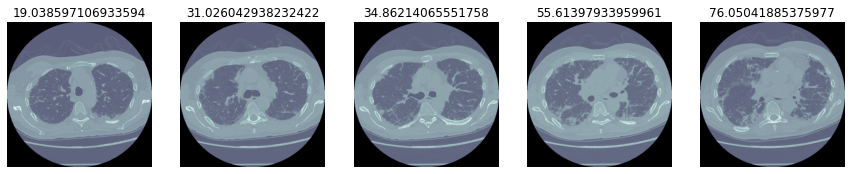

In [31]:
get_dicom_image(top5_dataframe, 'img_mean', source=train_source, folder_val='PatientID'\
                , instance_val='InstanceNumber', nrows=1)

### Saving different aspects

We used `show_aspects` earlier and now we will save the different aspects.  For each patient we specify a `save_path`.  To view the aspects you would toggle show to True.

In [ ]:
for i in unique_pats:
    source_path = f'{source}/train/{i}'
    save_path = f'{source}/aspects/{i}'
    show_aspects(source_path, show=True, save=True, save_path=save_path)

When using the save option in `show_aspects` you will get a warning:

`Lossy conversion from uint16 to uint8. Losing 8 bits of resolution. Convert image to uint8 prior to saving to suppress this warning.`

Ignore this warning as I will be explaining the differences between the different types in a future tutorial.

Lets check out how many files were saved in the new folder.

In [32]:
aspect_source = 'D:/Datasets/osic-pulmonary-fibrosis-progression/aspects'
aspect_items = get_image_files(aspect_source)
aspect_items

(#522) [Path('D:/Datasets/osic-pulmonary-fibrosis-progression/aspects/ID00007637202177411956430/axial.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/aspects/ID00007637202177411956430/coronal.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/aspects/ID00007637202177411956430/sagittall.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/aspects/ID00009637202177434476278/axial.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/aspects/ID00009637202177434476278/coronal.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/aspects/ID00009637202177434476278/sagittall.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/aspects/ID00010637202177584971671/axial.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/aspects/ID00010637202177584971671/coronal.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/aspects/ID00010637202177584971671/sagittall.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/aspects/ID0001263720

We will use these images in the DataBlock section below

### Get rid of areas of an image that have little impact

Viewing the histogram of the pixel distribution of an image can provide valuable insights.  There could be differences between images that represent a normal condition and one that has a diseased state.  It could also show pixels that provide no benefit in the training process.

`image_hist` is a handy function that plots the pixel distribution of an image. It also has added functionality ported from fastai.medical.imaging that creates masks based on dicom window and plots the corresponding histogram.  Here we use a sigma and a thresh of 0 as we want to see the original size of the image

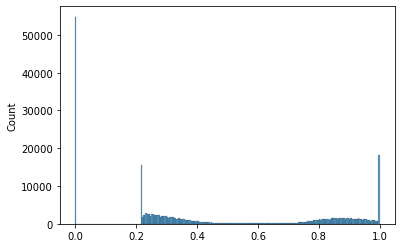

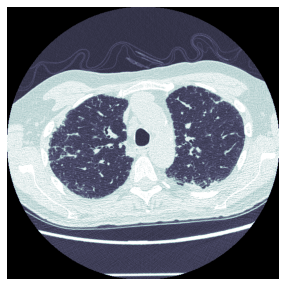

In [33]:
image_hist(top5_source[0],window=dicom_windows.lungs, sigma=0.0, thresh=0.0)

The histogram clearly shows an outlier area at value 0 which represents alot of background pixels that will not help with the training process.

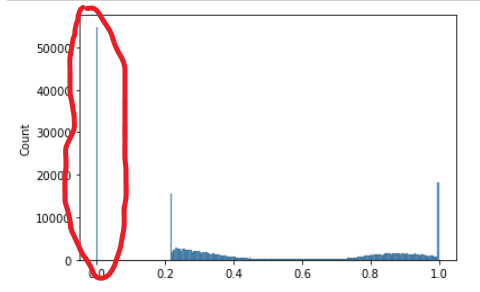

Playing around with the sigma and thresh values we can manipulate the image to minimize unwanted pixels.

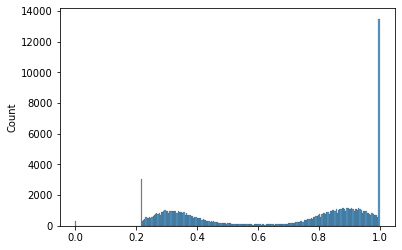

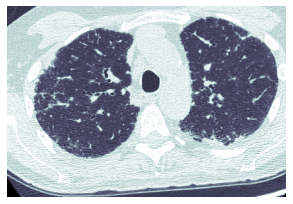

In [34]:
image_hist(top5_source[0],window=dicom_windows.lungs, sigma=0.9, thresh=0.5)

fmi has handy feature `mask_and_save_df` which can mask images based on the chosen window width and level and save the images as jpegs.

Lets look at the original size images(sigma and thresh set to 0).  In this case we are using the lungs window and just showing the images and not saving them.  If we do opt to save the images a `save_path` needs to be specified.

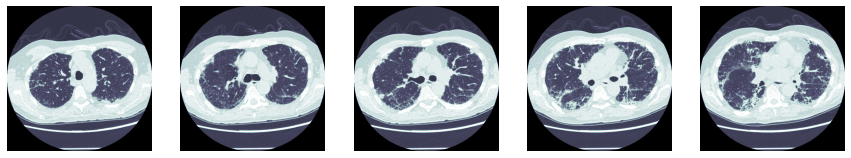

In [35]:
mask_and_save_df(top5_dataframe, folder='PatientID', source=train_source, window=dicom_windows.lungs\
                 ,sigma=0.0, thresh=0.0, show=True, save=False)

The images above have alot of areas that have no relevance in the training process, how about a sigma of 0.1 and a thresh of 0.5.

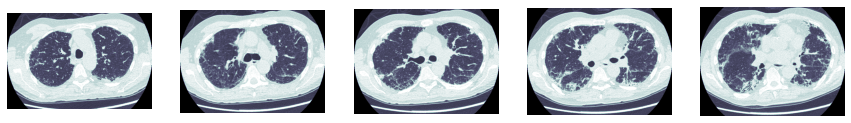

In [36]:
mask_and_save_df(top5_dataframe, folder='PatientID', source=train_source, window=dicom_windows.lungs\
                 ,sigma=0.1, thresh=0.5, show=True, save=False)

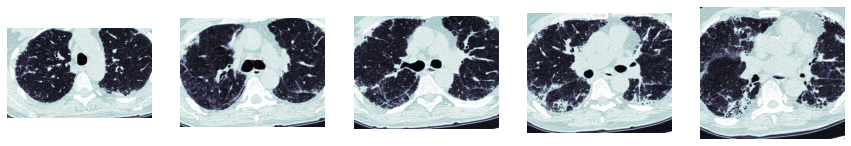

In [37]:
mask_and_save_df(top5_dataframe, folder='PatientID', source=train_source, window=dicom_windows.lungs\
                 ,sigma=0.7, thresh=0.6, show=True, save=False)

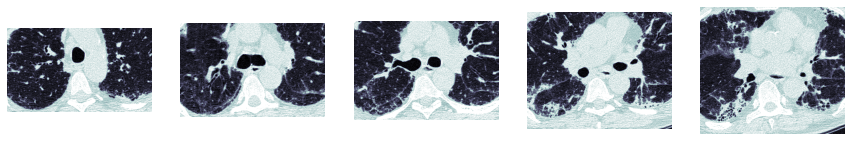

In [38]:
mask_and_save_df(top5_dataframe, folder='PatientID', source=train_source, window=dicom_windows.lungs\
                 ,sigma=0.9, thresh=0.6, show=True, save=False)

We can now save the files in jpg format by specifying a save path and switching `save` in `mask_and_save_df` to True.

In [39]:
mask_source = 'D:/Datasets/osic-pulmonary-fibrosis-progression/test_5/' #source files
mask_save = 'D:/Datasets/osic-pulmonary-fibrosis-progression/mask_test' #folder where masked files will be saved

c:\users\avird\anaconda3\envs\fastainew\lib\site-packages\fastai\torch_core.py:36: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax = plt.subplots(nrows, ncols, figsize=figsize, **kwargs)


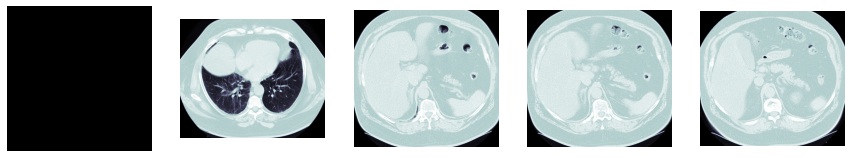

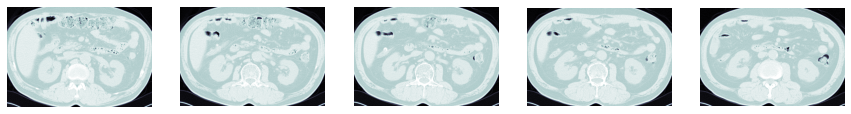

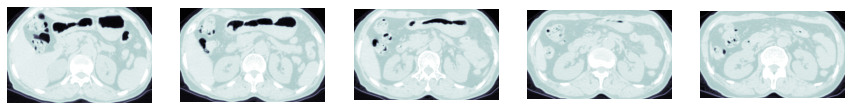

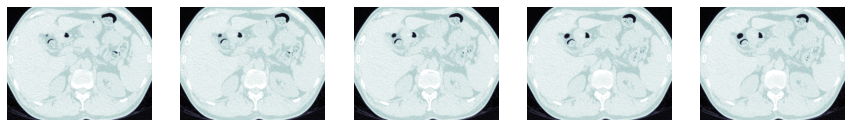

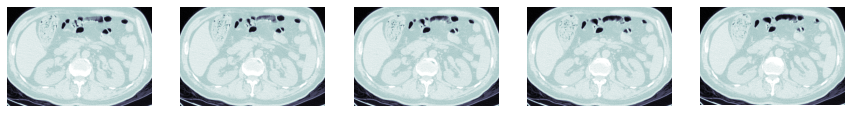

...

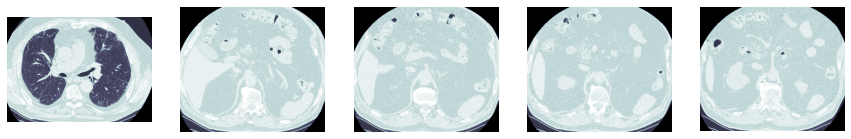

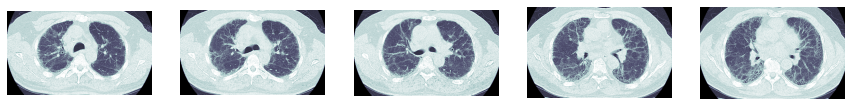

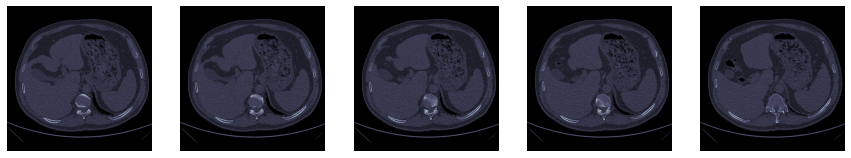

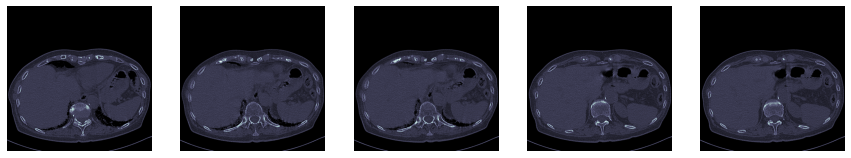

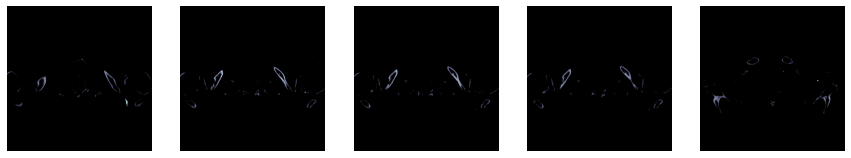

In [45]:
for i in unique_pats:
    files = get_dicom_files(f'{mask_source}/{i}')
    df = pd.DataFrame.from_dicoms(files, window=dicom_windows.lungs)
    save_path = f'{mask_save}/{i}'
    mask_and_save_df(df, folder='PatientID', source=train_source, window=dicom_windows.lungs\
                 ,sigma=0.30, thresh=0.65, show=True, save=True, save_path=save_path)

### Save images where each channel represents a dicom window width and level

Another option is to save a dicom image as a jpg where each channel represents a particular window width and level.  For example the R channel can display the lungs window, the G channel the mediastinum window and the B window the pe window.  Note the `pe` window is an addition from the fmi library.

`dicom_covert_3channel` is a function that can easily convert .dcm images and save them as .jpg where each channel represents a specific window width and level.  It has options to turn on or off whether to show and or save the images similar to `mask_and_save_df`

In this example we will look at 3 images from the dataset

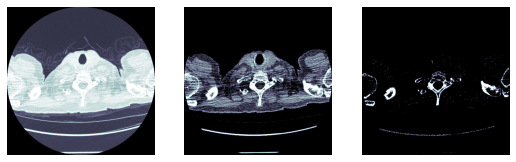

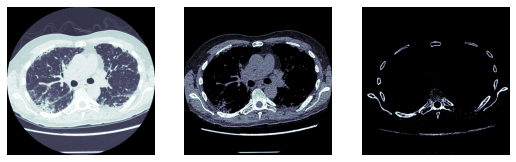

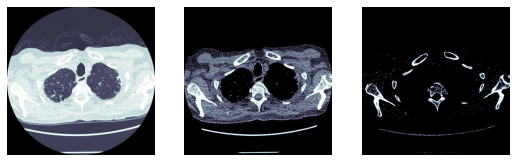

In [40]:
for file in os_items[0,5,25]:
    dicom_convert_3channel(file, show=True, save=False, save_dir=save_dir, win1=dicom_windows.lungs, \
                       win2=dicom_windows.mediastinum, win3=dicom_windows.pe)

Saving the images is pretty easy, specify a `save_path`

In [41]:
save_dir = 'D:/Datasets/osic-pulmonary-fibrosis-progression/test3c/'

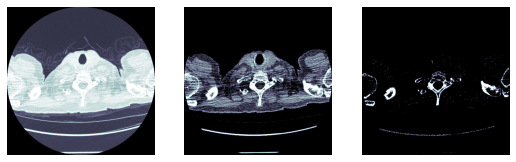

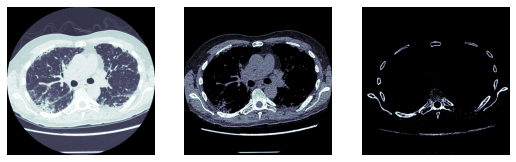

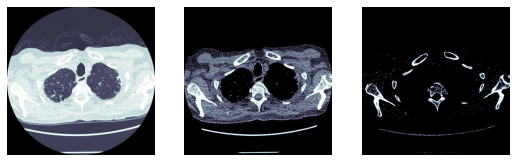

In [42]:
for file in os_items[0,5,25]:
    dicom_convert_3channel(file, show=True, save=True, save_dir=save_dir, win1=dicom_windows.lungs, \
                       win2=dicom_windows.mediastinum, win3=dicom_windows.pe)

Looking at a saved image, they are now saved in .jpg format so we can use standard `PILImage` to create the image

In [43]:
saved_image = PILImage.create('D:/Datasets/osic-pulmonary-fibrosis-progression/test3c/20.jpg')
saved_ten = TensorImage(saved_image)
saved_ten.shape

(512, 512, 3)

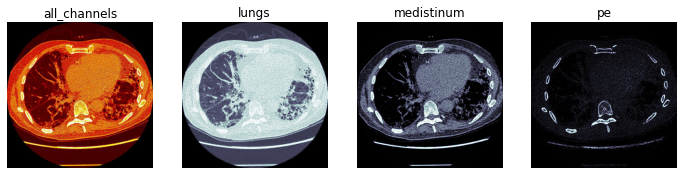

In [44]:
show_images([saved_ten[:,:,:], saved_ten[:,:,0], saved_ten[:,:,1], saved_ten[:,:,2]],\
            titles=['all_channels', 'lungs', 'medistinum', 'pe'])

In the OSIC dataset there is a `train` csv file

In [45]:
train_df = pd.read_csv(f'{source}/train.csv')
train_df

,Patient,Weeks,FVC,Percent,Age,Sex,SmokingStatus
0,ID00007637202177411956430,-4,2315,58.253649,79,Male,Ex-smoker
1,ID00007637202177411956430,5,2214,55.712129,79,Male,Ex-smoker
2,ID00007637202177411956430,7,2061,51.862104,79,Male,Ex-smoker
3,ID00007637202177411956430,9,2144,53.950679,79,Male,Ex-smoker
4,ID00007637202177411956430,11,2069,52.063412,79,Male,Ex-smoker
...,...,...,...,...,...,...,...
1544,ID00426637202313170790466,13,2712,66.594637,73,Male,Never smoked
1545,ID00426637202313170790466,19,2978,73.126412,73,Male,Never smoked
1546,ID00426637202313170790466,31,2908,71.407524,73,Male,Never smoked
1547,ID00426637202313170790466,43,2975,73.052745,73,Male,Never smoked


In this tutorial we will not be using the same end point as the OSIC competition.  Instead, to show how `dicom_splitter` (explained further below) works and for an example of creating a sample `DataBlock` we will use a different end point.  The train.csv file contains the Patient as well as the SmokingStatus so we will instead use the `PatientID` as our input and `SmokingStatus` as the label.

As we do not have a csv file that includes the 5 images per patient(that we created earlier) as well as the smoking status we will:

- Rename `patient` in the train.csv to `PatientID` so they match both dataframes
- Merge the two dataframes by `PatientID` so `SmokingStatus` is included in the sorted_5 dataframe that we created earlier

There are 1549 rows in train.csv however all we want is the smoking status for each patient so we will drop any duplicate rows

In [46]:
train_df.drop_duplicates('Patient', inplace=True)

In [47]:
len(train_df)

176

There are a total of 176 unique `Patient` values (2 more than our dataset because we removed 2 IDs as mentioned earlier)

Rename `Patient` to `PatientID` so that it matches both dataframes

In [48]:
train_df.rename(columns={'Patient':'PatientID'}, inplace=True)

Combine both dataframes

In [49]:
comb_df = sorted_five.join(train_df.set_index('PatientID'), on='PatientName')
comb_df.head()

,SpecificCharacterSet,ImageType,SOPInstanceUID,Modality,Manufacturer,ManufacturerModelName,PatientName,PatientID,PatientSex,DeidentificationMethod,...,TableFeedPerRotation,SpiralPitchFactor,SpacingBetweenSlices,SpatialResolution,Weeks,FVC,Percent,Age,Sex,SmokingStatus
0,ISO_IR 100,"['DERIVED', 'SECONDARY', 'REFORMATTED']",1.2.276.0.7230010.3.1.4.0.37492.1591423399.183666,CT,GE MEDICAL SYSTEMS,OsiriX,ID00105637202208831864134,ID00105637202208831864134,NaN,Table;,...,NaN,NaN,NaN,NaN,44,2479,66.454000,64,Male,Ex-smoker
1,NaN,"['ORIGINAL', 'PRIMARY', 'AXIAL', 'CT_SOM5 SPI']",2.25.67353959036675237221859696444881004919,CT,SIEMENS,Sensation 16,ID00331637202286306023714,ID00331637202286306023714,NaN,Table;,...,NaN,NaN,NaN,NaN,28,3135,94.644367,69,Male,Currently smokes
2,NaN,"['ORIGINAL', 'PRIMARY', 'AXIAL', 'CT_SOM5 SPI']",2.25.66078556054731154576830309137842816457,CT,SIEMENS,Sensation 16,ID00331637202286306023714,ID00331637202286306023714,NaN,Table;,...,NaN,NaN,NaN,NaN,28,3135,94.644367,69,Male,Currently smokes
3,NaN,"['ORIGINAL', 'PRIMARY', 'AXIAL', 'CT_SOM5 SPI']",2.25.149150135078074377701358458490416893263,CT,SIEMENS,Sensation 16,ID00331637202286306023714,ID00331637202286306023714,NaN,Table;,...,NaN,NaN,NaN,NaN,28,3135,94.644367,69,Male,Currently smokes
4,ISO_IR 100,"['ORIGINAL', 'PRIMARY', 'AXIAL', 'HELIX']",1.2.276.0.7230010.3.1.4.0.37492.1591342612.174453,CT,Philips,OsiriX,ID00285637202278913507108,ID00285637202278913507108,NaN,Table;,...,NaN,NaN,-10.0,NaN,4,1411,66.409375,61,Female,Never smoked


Save the dataframe as a csv

In [50]:
comb_df.to_csv(f'{source}/combined_df.csv', index=False)

### dicom_splitter

Dicom images provide unique nuggets of information that can help in ensuring that the same patient does not exist in both the training and validiation sets. Having the same patient in both sets may potentially skew the effectiveness of the model. `dicom_splitter` utilizes `IndexSplitter` and splits the index by `valid_pct` into a train and valid index.

It then checks to see if there are any duplicate patients and if there are it removes it from the valid index.

To see how `dicom_splitter` works we will use `dicomsplit_test`

`fmi` has a handy `random_` function that allows you to generate a random list of numbers.  In this example we use `random_` to generate  a list of 20 random numbers between 0 and the total number of items in a dataset

In [51]:
rand_items = random_(os_items, value=20)
rand_items

(#20) [Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00109637202210454292264/258.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00199637202248141386743/75.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00381637202299644114027/493.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00132637202222178761324/16.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00228637202259965313869/237.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00323637202285211956970/181.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00312637202282607344793/210.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00075637202198610425520/292.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00426637202313170790466/101.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/train/ID00210637202257228694086/75.dcm')...]

`check_duplicate` is a handy function that checks to see if there are any duplicate patients in the train and valid sets and if there are any duplicates, the duplicate values are removed from the validation index.

Train: 16 
 Original Validation: 4 
 Updated Validation: 4


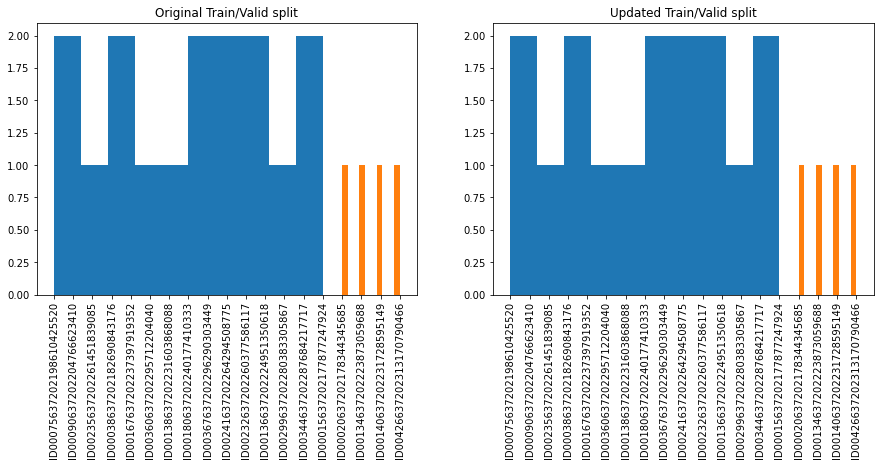

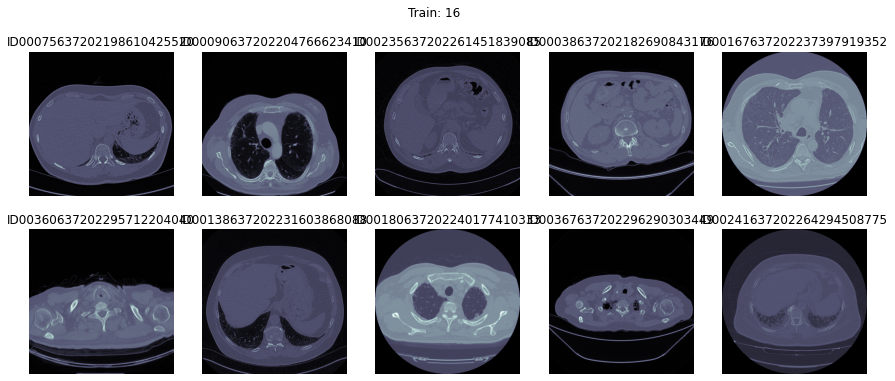

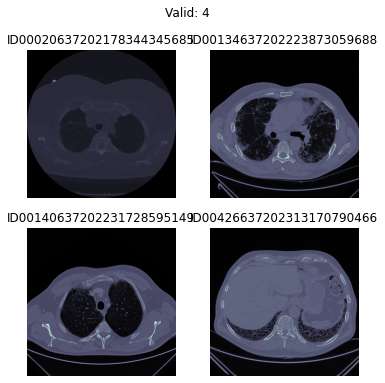

In [55]:
seed = 7
check_duplicate(rand_items, valid_pct=0.2, seed=seed)

In the example above we are used a `valid_pct` of 0.2 so out of the 20 images there are 16 images in the train set and 4 images in the valid set.  In this case there are no duplicate patients in the train and valid sets and this is also shown in the `Original Train/Valid Split` histograph where there is no overlap between the train(blue) and valid(orange) sets.

**What happens when there is/are duplicates?**

Train: 16 
 Original Validation: 4 
 Updated Validation: 3


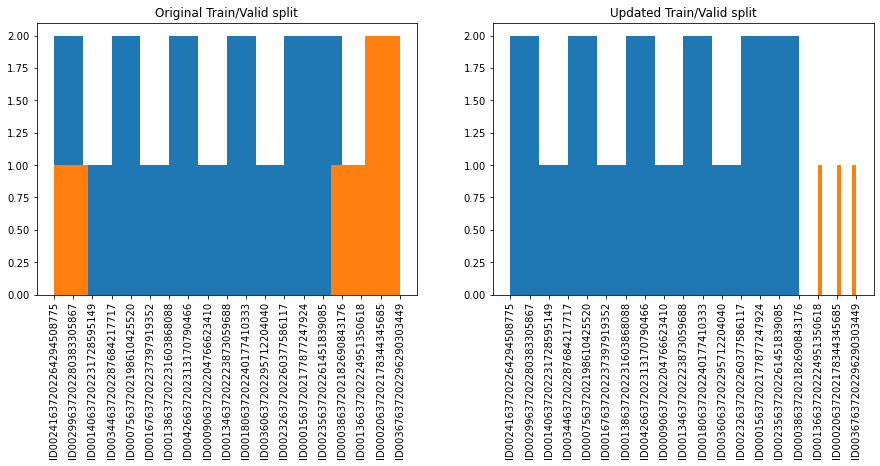

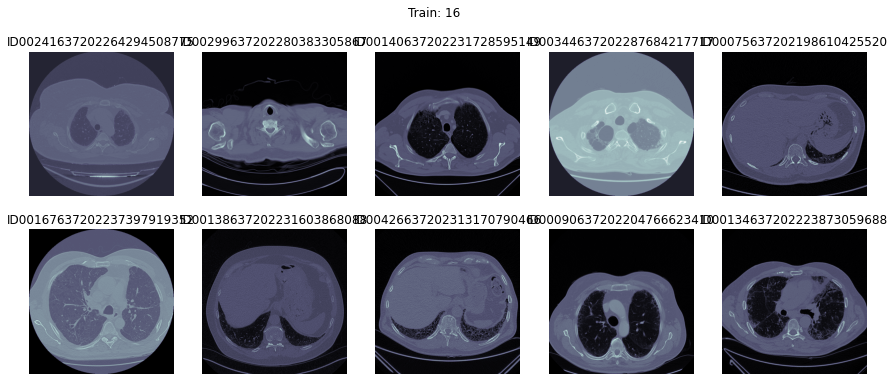

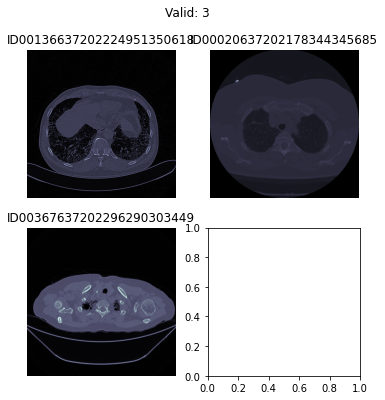

In [58]:
seed = 9
check_duplicate(rand_items, valid_pct=0.2, seed=seed)

In this case there is 1 duplicate which is then removed from the train set.  The updated valid index has changed from 4 to 3.

### DataBlock Examples

#### DataBlock 1

Using the 870 images we saved earlier by moving the top 5 images per patientID based on image window % from the train folder to a new folder named `test_5`

In [52]:
test_source = 'D:/Datasets/osic-pulmonary-fibrosis-progression/test_5'
combined_df = pd.read_csv(f'{source}/combined_df.csv')
test_items = get_dicom_files(test_source)
test_items

(#870) [Path('D:/Datasets/osic-pulmonary-fibrosis-progression/test_5/ID00007637202177411956430/10.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/test_5/ID00007637202177411956430/12.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/test_5/ID00007637202177411956430/13.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/test_5/ID00007637202177411956430/15.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/test_5/ID00007637202177411956430/17.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/test_5/ID00009637202177434476278/100.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/test_5/ID00009637202177434476278/89.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/test_5/ID00009637202177434476278/90.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/test_5/ID00009637202177434476278/95.dcm'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/test_5/ID00009637202177434476278/99.dcm')...]

In [53]:
set_seed(77)
get_x1 = ColReader('fname')
get_y1 = ColReader('SmokingStatus')

blocks = (ImageBlock(cls=PEWindow), CategoryBlock)
db = DataBlock(blocks=blocks,
                   get_x=get_x1,
                   splitter=dicom_splitter(test_items, valid_pct=0.9, seed=77),
                   item_tfms=Resize(512),
                   get_y=get_y1,
                   batch_tfms=[IntToFloatTensor(div=255)])

In [54]:
dls = db.dataloaders(combined_df, bs=8, num_workers=0)

765 105


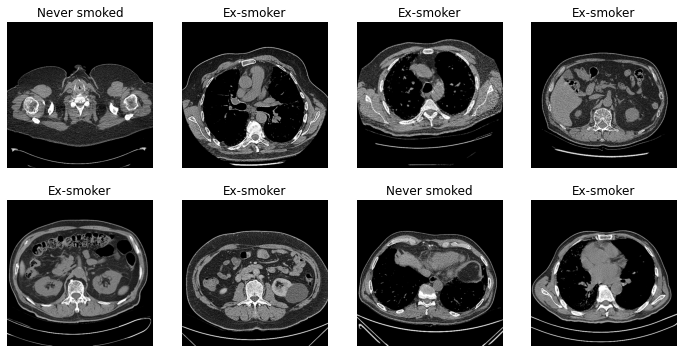

In [55]:
dls.show_batch()

`PEWindow` is not explained in this tutorial and is from the fmi.pipeline section.  The pipeline section will be explained in a forthcoming tutorial

#### DataBlock 2

In this example we use the masked images we created. As these are .jpg images we need to make a few changes, we use `get_image_files` instead of `get_dicom_images`, change the way we get `x`, change the `ImageBlock` and can no longer use `dicom_splitter` so change it to `RandomSplitter`

In [56]:
mask_source = 'D:/Datasets/osic-pulmonary-fibrosis-progression/mask_test'
mask_items = get_image_files(mask_source)
mask_items

(#870) [Path('D:/Datasets/osic-pulmonary-fibrosis-progression/mask_test/ID00007637202177411956430/10.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/mask_test/ID00007637202177411956430/12.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/mask_test/ID00007637202177411956430/13.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/mask_test/ID00007637202177411956430/15.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/mask_test/ID00007637202177411956430/17.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/mask_test/ID00009637202177434476278/100.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/mask_test/ID00009637202177434476278/89.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/mask_test/ID00009637202177434476278/90.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/mask_test/ID00009637202177434476278/95.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/mask_test/ID00009637202177434476278/99.jpg')..

In [57]:
set_seed(77)
get_x1 = lambda x:f'{mask_source}/{x.PatientID}/{str(x.InstanceNumber)}.jpg'
get_y1 = ColReader('SmokingStatus')

blocks = (ImageBlock, CategoryBlock)
db2 = DataBlock(blocks=blocks,
                   get_x=get_x1,
                   splitter=RandomSplitter(),
                   item_tfms=Resize(512),
                   get_y=get_y1,
                   batch_tfms=[IntToFloatTensor(div=255)])

In [58]:
dls2 = db2.dataloaders(combined_df, bs=8, num_workers=0)

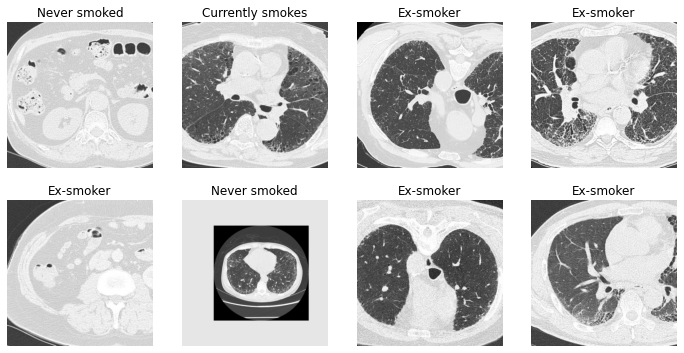

In [59]:
dls2.show_batch()

#### DataBlock 3

In this example we will use the aspects that we saved previously

In [60]:
aspect_source = 'D:/Datasets/osic-pulmonary-fibrosis-progression/aspects'
aspect_items = get_image_files(aspect_source)
aspect_items

(#522) [Path('D:/Datasets/osic-pulmonary-fibrosis-progression/aspects/ID00007637202177411956430/axial.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/aspects/ID00007637202177411956430/coronal.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/aspects/ID00007637202177411956430/sagittall.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/aspects/ID00009637202177434476278/axial.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/aspects/ID00009637202177434476278/coronal.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/aspects/ID00009637202177434476278/sagittall.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/aspects/ID00010637202177584971671/axial.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/aspects/ID00010637202177584971671/coronal.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/aspects/ID00010637202177584971671/sagittall.jpg'),Path('D:/Datasets/osic-pulmonary-fibrosis-progression/aspects/ID0001263720

Using the sagittall images

In [61]:
set_seed(77)
get_x1 = lambda x:f'{aspect_source}/{x.PatientID}/sagittall.jpg'
get_y1 = ColReader('SmokingStatus')

blocks = (ImageBlock, CategoryBlock)
db2 = DataBlock(blocks=blocks,
                   get_x=get_x1,
                   splitter=RandomSplitter(),
                   item_tfms=Resize(512),
                   get_y=get_y1,
                   batch_tfms=[IntToFloatTensor(div=255)])

In [62]:
dls2 = db2.dataloaders(combined_df, bs=8, num_workers=0)

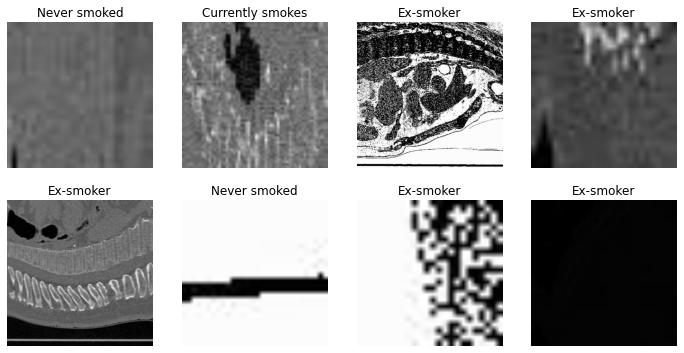

In [63]:
dls2.show_batch()

One interesting thing we note here is that there are clearly differences in the resolution of the images in this batch.  

>Note: This is because in this dataset different imaging machines were used.  It is important to put this into perspective when devising the training model.

How about the coronal aspects:

In [64]:
set_seed(77)
get_x1 = lambda x:f'{aspect_source}/{x.PatientID}/coronal.jpg'
get_y1 = ColReader('SmokingStatus')

blocks = (ImageBlock, CategoryBlock)
db2 = DataBlock(blocks=blocks,
                   get_x=get_x1,
                   splitter=RandomSplitter(),
                   item_tfms=Resize(512),
                   get_y=get_y1,
                   batch_tfms=[Resize(512), IntToFloatTensor(div=255)])

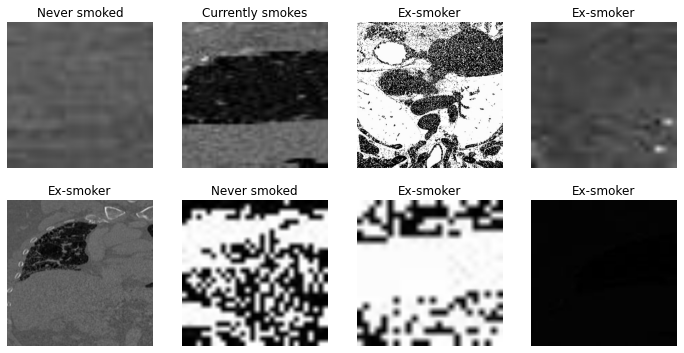

In [65]:
dls2 = db2.dataloaders(combined_df, bs=8, num_workers=0)
dls2.show_batch()

Again you notice differences in the images